In [1]:
import numpy as np
import cv2
from skimage.feature import hog
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import glob
import time
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler

In [2]:
def convert_color(img, conv='YCrCb'):
    #img is scaled b/w 0-1, cvtColor upscales it to 0-255. make sure we rescale it back to 0-1
    if conv != 'RGB':
        if conv == 'YCrCb':
            return cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)/255.
        if conv == 'LUV':
            return cv2.cvtColor(img, cv2.COLOR_RGB2LUV)/255.
        if conv == 'HSV':
            return cv2.cvtColor(img, cv2.COLOR_RGB2HSV)/255.
        if conv == 'HLS':
            return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)/255.
        if conv == 'YUV':
            return cv2.cvtColor(img, cv2.COLOR_RGB2YUV)/255.
    else:
        return img

def get_hog_features(img, orient, pix_per_cell, cell_per_block, 
                        vis=False, feature_vec=True):
    # Call with two outputs if vis==True
    if vis == True:
        features, hog_image = hog(img, orientations=orient, 
                                  pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), 
                                  transform_sqrt=False, 
                                  visualise=vis, feature_vector=feature_vec)
        return features, hog_image
    # Otherwise call with one output
    else:      
        features = hog(img, orientations=orient, 
                       pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), 
                       transform_sqrt=False, 
                       visualise=vis, feature_vector=feature_vec)
        return features

def bin_spatial(img, size=(32, 32)):
    color1 = cv2.resize(img[:,:,0], size).ravel()
    color2 = cv2.resize(img[:,:,1], size).ravel()
    color3 = cv2.resize(img[:,:,2], size).ravel()
    return np.hstack((color1, color2, color3))
                        
def color_hist(img, nbins=32):    #bins_range=(0, 256)
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins)
    channel2_hist = np.histogram(img[:,:,1], bins=nbins)
    channel3_hist = np.histogram(img[:,:,2], bins=nbins)
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    # Return the individual histograms, bin_centers and feature vector
    return hist_features

In [3]:
# Define a function to extract features from a list of images
# Have this function call bin_spatial() and color_hist()
def extract_features(imgs, color_space='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
    for file in imgs:#TODO use all when training
        file_features = []
        # Read in each one by one
        feature_image = mpimg.imread(file).astype(np.float32)# mpimg reads png images in scale 0-1
        # apply color conversion if other than 'RGB'
        feature_image = convert_color(feature_image, color_space)  
        if spatial_feat == True:
            spatial_features = bin_spatial(feature_image, size=spatial_size)
            file_features.append(spatial_features)
        if hist_feat == True:
            # Apply color_hist()
            hist_features = color_hist(feature_image, nbins=hist_bins)
            file_features.append(hist_features)
        if hog_feat == True:
        # Call get_hog_features() with vis=False, feature_vec=True
            hog_features = []
            if hog_channel == 'ALL':
                for channel in range(feature_image.shape[2]):
                    hog_features.append(get_hog_features(feature_image[:,:,channel], 
                                        orient, pix_per_cell, cell_per_block, 
                                        vis=False, feature_vec=True))
                hog_features = np.ravel(hog_features)        
            else:
                hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                            pix_per_cell, cell_per_block, vis=False, feature_vec=True)
            # Append the new feature vector to the features list
            file_features.append(hog_features)
        features.append(np.concatenate(file_features))
    # Return list of feature vectors
    return features

In [4]:
# Define a single function that can extract features using hog sub-sampling and make predictions
def find_cars(img, ystart, ystop,color_space, scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins):
    
    # mpimg reads jpg images in scale 0-255, as we trained our extracted features for training classifier
    # is in range of 0-1, make sure our test video jpg image is scaled b/w 0-255
    img = img.astype(np.float32)/255. 
    
    img_tosearch = img[ystart:ystop,:,:]
    ctrans_tosearch = convert_color(img_tosearch, color_space)
    #print(ctrans_tosearch.shape)
    if scale != 1:
        imshape = ctrans_tosearch.shape
        ctrans_tosearch = cv2.resize(ctrans_tosearch, (np.int(imshape[1]/scale), np.int(imshape[0]/scale)))
    
    #print(ctrans_tosearch.shape)
    ch1 = ctrans_tosearch[:,:,0]
    ch2 = ctrans_tosearch[:,:,1]
    ch3 = ctrans_tosearch[:,:,2]

    #print(ch1.shape)
    # Define blocks and steps as above
    nxblocks = (ch1.shape[1] // pix_per_cell)+1 # -1??
    nyblocks = (ch1.shape[0] // pix_per_cell)+1 # -1??
    nfeat_per_block = orient*cell_per_block**2
    #print(nxblocks)
    #print(nyblocks)
    # 64 was the orginal sampling rate, with 8 cells and 8 pix per cell
    window = 64
    nblocks_per_window = (window // pix_per_cell)-1
    #print(nblocks_per_window)
    cells_per_step = 2  # Instead of overlap, define how many cells to step
    nxsteps = (nxblocks - nblocks_per_window) // cells_per_step
    nysteps = (nyblocks - nblocks_per_window) // cells_per_step
    
    # Compute individual channel HOG features for the entire image
    hog1 = get_hog_features(ch1, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog2 = get_hog_features(ch2, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog3 = get_hog_features(ch3, orient, pix_per_cell, cell_per_block, feature_vec=False)
    
    car_boundaries = []
    search_boundaries = []
    #print(nxsteps)
    #print(nysteps)
    for xb in range(nxsteps):
        for yb in range(nysteps):
            ypos = yb*cells_per_step
            xpos = xb*cells_per_step
            # Extract HOG for this patch
            hog_feat1 = hog1[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat2 = hog2[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat3 = hog3[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_features = np.hstack((hog_feat1, hog_feat2, hog_feat3))

            xleft = xpos*pix_per_cell
            ytop = ypos*pix_per_cell

            #print(xleft)
            #print(ytop)
            
            # Extract the image patch
            subimg = cv2.resize(ctrans_tosearch[ytop:ytop+window, xleft:xleft+window], (64,64))
          
            # Get color features
            spatial_features = bin_spatial(subimg, size=spatial_size)
            hist_features = color_hist(subimg, nbins=hist_bins)

            # Scale features and make a prediction
            test_features = X_scaler.transform(np.hstack((spatial_features, hist_features, hog_features)).reshape(1, -1))    
            test_prediction = svc.predict(test_features)
            test_prediction_decision = svc.decision_function(test_features)
            
            xbox_left = np.int(xleft*scale)
            ytop_draw = np.int(ytop*scale)
            win_draw = np.int(window*scale) 
            search_boundaries.append(((xbox_left, ytop_draw+ystart),(xbox_left+win_draw,ytop_draw+win_draw+ystart)))
            if test_prediction == 1 and test_prediction_decision > 0.1:
                car_boundaries.append(((xbox_left, ytop_draw+ystart),(xbox_left+win_draw,ytop_draw+win_draw+ystart)))
    return search_boundaries, car_boundaries
                                        

# Train classifier

In [5]:
# get paths of images
cars = glob.glob('./vehicles/*/*.png')
notcars = glob.glob('./non-vehicles/*/*.png')
print(len(cars))
print(len(notcars))

8792
8968


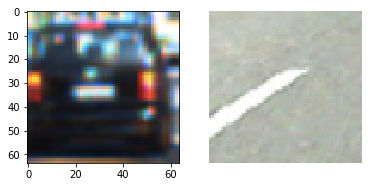

In [6]:
import matplotlib.gridspec as gridspec
import random
gs1 = gridspec.GridSpec(1, 2)
gs1.update(wspace=0.01, hspace=0.02) # set the spacing between axes.
#plt.figure(figsize=(12,12))
random_car_image_idx = random.sample(range(0, len(cars)), 1)
random_non_car_img_idx = random.sample(range(0, len(notcars)), 1)
plt.subplot(1,2,1)
plt.imshow(mpimg.imread(cars[random_car_image_idx[0]]))
plt.subplot(1,2,2)
plt.imshow(mpimg.imread(notcars[random_non_car_img_idx[0]]))
plt.axis('off')
plt.show()

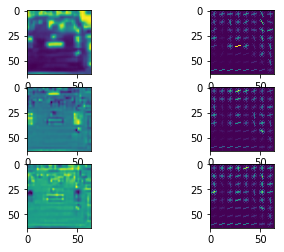

In [7]:
gs1 = gridspec.GridSpec(3, 2)
gs1.update(wspace=0.01, hspace=0.02) # set the spacing between axes.
random_img = convert_color(mpimg.imread(cars[random_car_image_idx[0]]), conv='YCrCb')
plt.subplot(3,2,1)
plt.imshow(random_img[:,:,0])
plt.subplot(3,2,2)
random_img_features, random_img_hog_image = get_hog_features(random_img[:,:,0], 9, 8, 2, vis=True, feature_vec=True)
plt.imshow(random_img_hog_image)
plt.subplot(3,2,3)
plt.imshow(random_img[:,:,1])
plt.subplot(3,2,4)
random_img_features, random_img_hog_image = get_hog_features(random_img[:,:,1], 9, 8, 2, vis=True, feature_vec=True)
plt.imshow(random_img_hog_image)
plt.subplot(3,2,5)
plt.imshow(random_img[:,:,2])
plt.subplot(3,2,6)
random_img_features, random_img_hog_image = get_hog_features(random_img[:,:,2], 9, 8, 2, vis=True, feature_vec=True)
plt.imshow(random_img_hog_image)
plt.show()

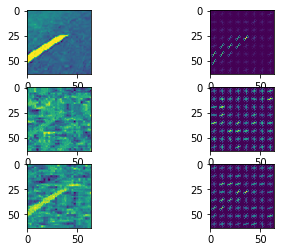

In [8]:
gs1 = gridspec.GridSpec(3, 2)
gs1.update(wspace=0.01, hspace=0.02) # set the spacing between axes.
random_img = convert_color(mpimg.imread(notcars[random_non_car_img_idx[0]]), conv='YCrCb')
plt.subplot(3,2,1)
plt.imshow(random_img[:,:,0])
plt.subplot(3,2,2)
random_img_features, random_img_hog_image = get_hog_features(random_img[:,:,0], 9, 8, 2, vis=True, feature_vec=True)
plt.imshow(random_img_hog_image)
plt.subplot(3,2,3)
plt.imshow(random_img[:,:,1])
plt.subplot(3,2,4)
random_img_features, random_img_hog_image = get_hog_features(random_img[:,:,1], 9, 8, 2, vis=True, feature_vec=True)
plt.imshow(random_img_hog_image)
plt.subplot(3,2,5)
plt.imshow(random_img[:,:,2])
plt.subplot(3,2,6)
random_img_features, random_img_hog_image = get_hog_features(random_img[:,:,2], 9, 8, 2, vis=True, feature_vec=True)
plt.imshow(random_img_hog_image)
plt.show()

In [9]:
X_train, X_test, y_train, y_test = [], [], [], []
#Extract features frm images

color_space = 'YCrCb' # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
orient = 9  # HOG orientations
pix_per_cell = 8 # HOG pixels per cell
cell_per_block = 2 # HOG cells per block
hog_channel = "ALL" # Can be 0, 1, 2, or "ALL"
spatial_size = (32, 32) # Spatial binning dimensions
hist_bins = 32    # Number of histogram bins
spatial_feat = True # Spatial features on or off
hist_feat = True # Histogram features on or off
hog_feat = True # HOG features on or off

car_features = extract_features(cars, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)
notcar_features = extract_features(notcars, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)

X = np.vstack((car_features, notcar_features)).astype(np.float64)                        
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X)
# Apply the scaler to X
scaled_X = X_scaler.transform(X)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))


In [10]:
from sklearn.model_selection import train_test_split
#randomize and split train and test data
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(scaled_X, y, test_size=0.2, random_state=rand_state)

#reset temp variables scaled_X, y, X
scaled_X = []
y = []
X = []

In [11]:
#Train Classifier
# Use a linear SVC 
svc = LinearSVC(C=0.1)
t=time.time()
svc.fit(X_train, y_train)
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train SVC...')
# Check the score of the SVC
print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 4))
# Check the prediction time for a single sample
t=time.time()

30.32 Seconds to train SVC...
Test Accuracy of SVC =  0.9887


In [12]:
#print(svc.best_params_)

In [13]:
'''
%matplotlib inline
img = mpimg.imread('./test_images/test4.jpg')

color_spaces = ['RGB', 'HSV', 'LUV', 'HLS', 'YUV', 'YCrCb']
transferred_imgs = []
for color_space in color_spaces:
    transferred_imgs.append(convert_color(img, color_space, True))

plt_cols = 3
plt_rows = len(transferred_imgs)#for 3 colors
print(transferred_imgs[0][:,:,0].shape)
#plt.imshow(transferred_imgs[3][:,:,2])


plt.figure(1, figsize=(120, 100), tight_layout=True)
i = 1
for img_num in range(len(transferred_imgs)):
    for j in range(plt_cols):
        plt.subplot(plt_rows, plt_cols,i)
        plt.imshow(transferred_imgs[img_num][:,:,j])
        plt.title(color_spaces[img_num])
        i = i+1
        plt.axis('off')
plt.show()
'''

"\n%matplotlib inline\nimg = mpimg.imread('./test_images/test4.jpg')\n\ncolor_spaces = ['RGB', 'HSV', 'LUV', 'HLS', 'YUV', 'YCrCb']\ntransferred_imgs = []\nfor color_space in color_spaces:\n    transferred_imgs.append(convert_color(img, color_space, True))\n\nplt_cols = 3\nplt_rows = len(transferred_imgs)#for 3 colors\nprint(transferred_imgs[0][:,:,0].shape)\n#plt.imshow(transferred_imgs[3][:,:,2])\n\n\nplt.figure(1, figsize=(120, 100), tight_layout=True)\ni = 1\nfor img_num in range(len(transferred_imgs)):\n    for j in range(plt_cols):\n        plt.subplot(plt_rows, plt_cols,i)\n        plt.imshow(transferred_imgs[img_num][:,:,j])\n        plt.title(color_spaces[img_num])\n        i = i+1\n        plt.axis('off')\nplt.show()\n"

In [14]:
'''
from skimage import data, color, exposure
#check hog features
plt_cols = 3
plt_rows = len(transferred_imgs)#for 3 colors
print(transferred_imgs[0][:,:,0].shape)
#plt.imshow(transferred_imgs[3][:,:,2])


plt.figure(1, figsize=(120, 100), tight_layout=True)
i = 1
for img_num in range(len(transferred_imgs)):
    for j in range(plt_cols):
        plt.subplot(plt_rows, plt_cols,i)
        features, hog_img = get_hog_features(transferred_imgs[img_num][:,:,j], orient=8, pix_per_cell=16, cell_per_block=1, vis=True, feature_vec=True)
        hog_image_rescaled = exposure.rescale_intensity(hog_img, in_range=(0, 0.02))
        plt.imshow(hog_image_rescaled)
        plt.title(color_spaces[img_num])
        i = i+1
        plt.axis('off')
plt.show()
'''

"\nfrom skimage import data, color, exposure\n#check hog features\nplt_cols = 3\nplt_rows = len(transferred_imgs)#for 3 colors\nprint(transferred_imgs[0][:,:,0].shape)\n#plt.imshow(transferred_imgs[3][:,:,2])\n\n\nplt.figure(1, figsize=(120, 100), tight_layout=True)\ni = 1\nfor img_num in range(len(transferred_imgs)):\n    for j in range(plt_cols):\n        plt.subplot(plt_rows, plt_cols,i)\n        features, hog_img = get_hog_features(transferred_imgs[img_num][:,:,j], orient=8, pix_per_cell=16, cell_per_block=1, vis=True, feature_vec=True)\n        hog_image_rescaled = exposure.rescale_intensity(hog_img, in_range=(0, 0.02))\n        plt.imshow(hog_image_rescaled)\n        plt.title(color_spaces[img_num])\n        i = i+1\n        plt.axis('off')\nplt.show()\n"

In [15]:
def get_boundaries(img):
    boundaries_list = []
    search_boundaries = []
    '''
    search_boundaries_list = [[400, 464, 1],
                              [400, 528, 1],
                              [400, 656, 1]]
    '''

    search_boundaries_list = [[400, 464, 1],
                              [400, 496, 1.5],
                              [400, 528, 2],
                              [400, 560, 2.5],
                              [400, 592, 3],
                              [400, 624, 3.5]]

    '''
    search_boundaries_list = [[400, 464, 1],
                              [416, 480, 1],
                              [400, 496, 1.5],
                              [432, 528, 1.5],
                              [400, 528, 2],
                              [432, 560, 2],
                              [400, 560, 2.5],
                              [432, 592, 2.5],
                              [400, 592, 3],
                              [432, 624, 3],
                              [400, 624, 3.5],
                              [432, 656, 3.5]]
    '''
    '''
    search_boundaries_list = [[400, 656, 1],
                              [416, 656, 1],
                              [400, 656, 1.5],
                              [432, 656, 1.5],
                              [400, 656, 2],
                              [432, 656, 2],
                              [400, 656, 2.5],
                              [432, 656, 2.5],
                              [400, 656, 3],
                              [432, 656, 3],
                              [400, 656, 3.5],
                              [432, 656, 3.5]]
    '''
    
    for start_stop_item in search_boundaries_list:
        ystart = start_stop_item[0]
        ystop = start_stop_item[1]
        scale = start_stop_item[2]
        search_tuple, found_tuple = find_cars(np.copy(img), ystart, ystop, color_space, scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins)
        if(len(found_tuple) > 0):
            for item in found_tuple:
                boundaries_list.append(item)
        if(len(search_tuple) > 0):
            for item in search_tuple:
                search_boundaries.append(item)
    return search_boundaries, boundaries_list

In [16]:
%matplotlib inline

test_images_list = glob.glob('./test_images/*.jpg')
plt.figure(1, figsize=(120, 100), tight_layout=True)
i = 1;
for test_image in test_images_list:
    test_img = mpimg.imread(test_image)
    search_boundaries, found_boundaries = get_boundaries(test_img)
    out_img = np.copy(test_img)
    for bbox in search_boundaries:
        out_img = cv2.rectangle(out_img, bbox[0], bbox[1], (255,0,0), 6)
    plt.subplot(6, 3,i)
    plt.imshow(test_img)
    plt.title('test image')
    i = i+1
    plt.subplot(6, 3,i)
    plt.imshow(out_img)
    plt.title('boundaries')
    i = i+1
    out_img = np.copy(test_img)
    for bbox in found_boundaries:
        out_img = cv2.rectangle(out_img, bbox[0], bbox[1], (255,0,0), 6)
    plt.subplot(6, 3,i)
    plt.imshow(out_img)
    plt.title('car boundaries')
    i = i+1
    plt.axis('off')
plt.show()


'''
test_images_list = glob.glob('./test_images/*.jpg')
plt.figure(1, figsize=(120, 100), tight_layout=True)
i = 1;
for test_image in test_images_list:
    test_img = mpimg.imread(test_image)
    search_boundaries, found_boundaries = get_boundaries(test_img)
    out_img = np.copy(test_img)
    for bbox in search_boundaries:
        out_img = cv2.rectangle(out_img, bbox[0], bbox[1], (255,0,0), 6)
    plt.subplot(6, 3,i)
    plt.imshow(test_img)
    plt.title('test image')
    i = i+1
    plt.subplot(6, 3,i)
    plt.imshow(out_img)
    plt.title('boundaries')
    i = i+1
    out_img = np.copy(test_img)
    found_rect_coord = []
    for bbox in found_boundaries:
        found_rect_coord.append([bbox[0][0], bbox[0][1], bbox[1][0], bbox[1][1]])
    #for bbox in found_boundaries:
    #    out_img = cv2.rectangle(out_img, bbox[0], bbox[1], (255,0,0), 6)
    grouped_rects = cv2.groupRectangles(found_rect_coord, 1)
    for bbox in grouped_rects[0]:
        out_img = cv2.rectangle(out_img, (bbox[0], bbox[1]), (bbox[2], bbox[3]), (255,0,0), 6)
    plt.subplot(6, 3,i)
    plt.imshow(out_img)
    plt.title('car boundaries')
    i = i+1
    plt.axis('off')
plt.show()
'''

/Users/nareshaluri/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/matplotlib/figure.py:1742: UserWarning: This figure includes Axes that are not compatible with tight_layout, so its results might be incorrect.
  warnings.warn("This figure includes Axes that are not "


"\ntest_images_list = glob.glob('./test_images/*.jpg')\nplt.figure(1, figsize=(120, 100), tight_layout=True)\ni = 1;\nfor test_image in test_images_list:\n    test_img = mpimg.imread(test_image)\n    search_boundaries, found_boundaries = get_boundaries(test_img)\n    out_img = np.copy(test_img)\n    for bbox in search_boundaries:\n        out_img = cv2.rectangle(out_img, bbox[0], bbox[1], (255,0,0), 6)\n    plt.subplot(6, 3,i)\n    plt.imshow(test_img)\n    plt.title('test image')\n    i = i+1\n    plt.subplot(6, 3,i)\n    plt.imshow(out_img)\n    plt.title('boundaries')\n    i = i+1\n    out_img = np.copy(test_img)\n    found_rect_coord = []\n    for bbox in found_boundaries:\n        found_rect_coord.append([bbox[0][0], bbox[0][1], bbox[1][0], bbox[1][1]])\n    #for bbox in found_boundaries:\n    #    out_img = cv2.rectangle(out_img, bbox[0], bbox[1], (255,0,0), 6)\n    grouped_rects = cv2.groupRectangles(found_rect_coord, 1)\n    for bbox in grouped_rects[0]:\n        out_img = cv2.

In [17]:
def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1
    # Return updated heatmap
    return heatmap

def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap < threshold] = 0
    # Return thresholded map
    return heatmap

def draw_labeled_bboxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        #print(nonzero)
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        #print(nonzeroy)
        #print(nonzerox)
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (255,0,0), 6)
    # Return the image
    return img

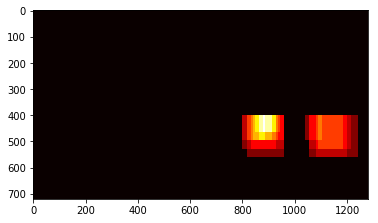

In [18]:
from scipy.ndimage.measurements import label
heatmap = np.zeros_like(test_img[:,:,0]).astype(np.float)
heatmap = add_heat(heatmap, found_boundaries)
heatmap = apply_threshold(heatmap , 2)
heatmap = np.clip(heatmap, 0, 255)
labels = label(heatmap)
plt.imshow(heatmap, cmap='hot')

In [19]:
from scipy.ndimage.measurements import label
prev_frames_heat_map = []
def pipeline(img):
    heatmap = np.zeros_like(img[:,:,0]).astype(np.float)
    global prev_frames_heat_map
    search_boundaries, car_boundaries = get_boundaries(img)
    heatmap = add_heat(heatmap, car_boundaries)
    #heatmap = apply_threshold(heatmap , 2)
    prev_frames_heat_map.append(heatmap)# append current heat map to cached frames list
    if len(prev_frames_heat_map) > 15: #maintain for last 15 frames
        prev_frames_heat_map = prev_frames_heat_map[len(prev_frames_heat_map)-15:]
    for h_map in prev_frames_heat_map:
        heatmap = heatmap + h_map
    heatmap = np.clip(heatmap, 0, 255)
    heatmap = apply_threshold(heatmap , 1+len(prev_frames_heat_map))
    labels = label(heatmap)
    processed_img = draw_labeled_bboxes(np.copy(img), labels)
    return processed_img

/Users/nareshaluri/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/matplotlib/figure.py:1742: UserWarning: This figure includes Axes that are not compatible with tight_layout, so its results might be incorrect.
  warnings.warn("This figure includes Axes that are not "


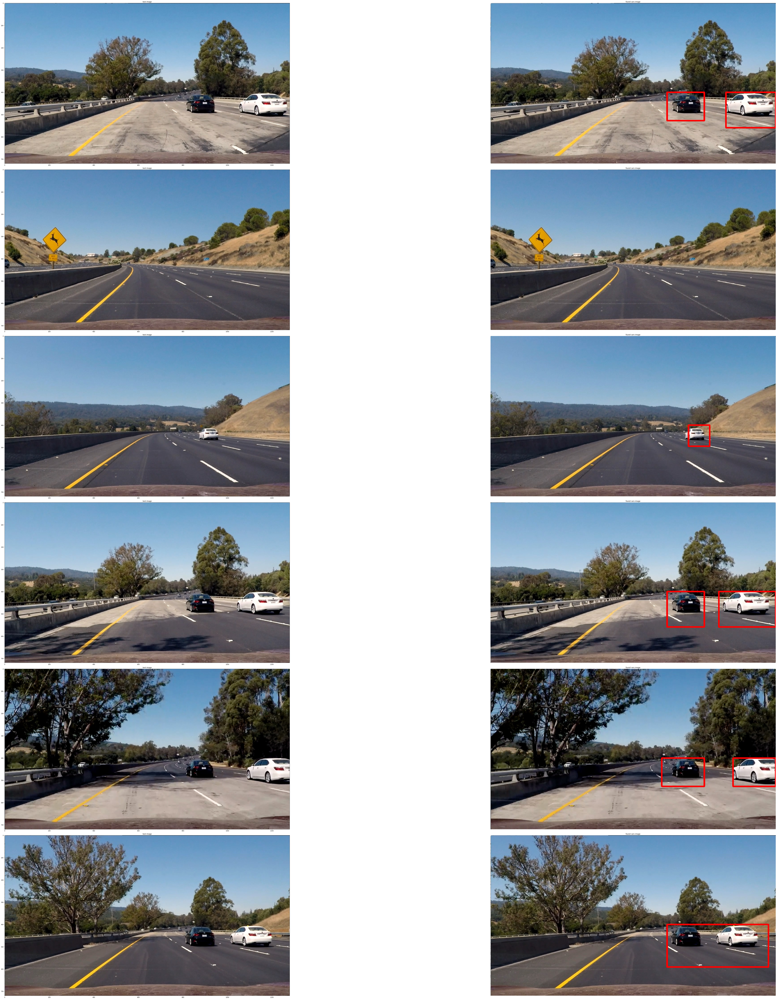

In [20]:
%matplotlib inline
test_images_list = glob.glob('./test_images/*.jpg')
plt.figure(1, figsize=(120, 100), tight_layout=True)
i = 1;
for test_image in test_images_list:
    global prev_frames_heat_map
    prev_frames_heat_map = []
    test_img = mpimg.imread(test_image)
    found_cars_image = pipeline(np.copy(test_img))
    plt.subplot(6, 2,i)
    plt.imshow(test_img)
    plt.title('test image')
    i = i+1
    plt.subplot(6, 2,i)
    plt.imshow(found_cars_image)
    plt.title('found cars image')
    i = i+1
    plt.axis('off')
plt.show()

In [21]:
from moviepy.editor import VideoFileClip
prev_frames_heat_map = []
white_output = 'test_video_output.mp4'
clip1 = VideoFileClip("test_video.mp4")
white_clip = clip1.fl_image(pipeline) 

%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video test_video_output.mp4
[MoviePy] Writing video test_video_output.mp4


 97%|█████████▋| 38/39 [00:34<00:00,  1.08it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_video_output.mp4 

CPU times: user 31.5 s, sys: 3.77 s, total: 35.2 s
Wall time: 37 s


In [22]:
from IPython.display import HTML
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))

In [23]:
from moviepy.editor import VideoFileClip
prev_frames_heat_map = []
white_output = 'project_video_output.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(pipeline) 

%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [19:44<00:00,  1.08it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 17min 26s, sys: 2min 8s, total: 19min 35s
Wall time: 19min 46s


In [24]:
from IPython.display import HTML
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))